In [1]:
import numpy as np
import scanpy as sc
import pandas as pd
import torch
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import classification_report
import scarches
from scarches.dataset import remove_sparsity
from lataq.models import EMBEDCVAE, TRANVAE

sc.settings.set_figure_params(dpi=600, frameon=False)
sc.set_figure_params(dpi=600)
torch.set_printoptions(precision=3, sci_mode=False, edgeitems=7)

def set_axis_style(ax, labels):
    ax.get_xaxis().set_tick_params(direction='out')
    ax.xaxis.set_ticks_position('bottom')
    ax.set_xticks(np.arange(1, len(labels) + 1))
    ax.set_xticklabels(labels)
    ax.set_xlim(0.25, len(labels) + 0.75)
    ax.set_xlabel('Sample name')
    
%load_ext autoreload
%autoreload 2

Global seed set to 0


In [2]:
adata_emb = sc.read('../data/soroor_rerun/czi_8m_pbmc_sample_embedding_fulldataset.h5ad')

/home/icb/carlo.dedonno/anaconda3/envs/lataq_cuda/lib/python3.8/site-packages/anndata/_core/anndata.py:121: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


In [3]:
adata_raw = sc.read('../data/pbmc_raw.h5ad')

In [6]:
batch_map = {
    "10_1016_j_cell_2020_08_001_10x 3' v2": 'Zieburh2020 (1)',
    "10_1016_j_cell_2020_08_001_10x 3' v3": 'Zieburh2020 (2)',
    "10_1016_j_cell_2021_01_053_convalescence_10x 3' v3": 'Zhang2021 (1)',
    "10_1016_j_cell_2021_01_053_convalescence_10x 5' v2": 'Zhang2021 (2)',
    "10_1016_j_cell_2021_01_053_nonconvalescence_10x 3' v3": 'Zhang2021 (3)',
    "10_1016_j_cell_2021_01_053_nonconvalescence_10x 5' v2": 'Zhang2021 (4)',
    "10_1016_j_cell_2021_02_018": 'Tsang2021',
    "10_1016_j_cell_2022_01_012": 'COMBAT2022',
    "10_1016_j_immuni_2021_03_005": 'Farber2021',
    "10_1016_j_isci_2021_102404": 'Bumol2021',
    "10_1038_s41467_019_12464_3": "Sims2019",
    "10_1038_s41467_020_17834_w": "Qu2020",
    "10_1038_s41586_020_2922_4_10x": "Krasnow2020",
    "10_1038_s41586_021_04345_x": "Meyer2021",
    "10_1038_s41591_020_0944_y": "Blish2020",
    "10_1038_s41591_021_01329_2_Cambridge": "Haniffa2021 (1)",
    "10_1038_s41591_021_01329_2_Ncl": "Haniffa2021 (2)",
    "10_1038_s41591_021_01329_2_Sanger": "Haniffa2021 (3)",
    "10_1101_2021_07_19_452956_blood_10x 3' v3": "TabulaSapiens2022",
    "10_1126_science_abc6261": "Pulendran2020",
    "10_1126_sciimmunol_abd1554": "Shin2020",
    "10_1126_scitranslmed_abh2624": "Ye2021",
    "nygc_pbmc": "Satija2021",
    "powell_eqtl": "Powell2022",
    "ye_lupus": "Ye2022",
}

In [7]:
annot = sc.queries.biomart_annotations(
        "hsapiens",
        ["external_gene_name", "ensembl_gene_id"],
    ).set_index("ensembl_gene_id")
adata_raw.var[annot.columns] = annot
adata_raw.var.drop_duplicates(subset='external_gene_name')
adata_raw = adata_raw[:, adata_raw.var.drop_duplicates(subset='external_gene_name').index]
adata_raw = adata_raw[:, ~(adata_raw.var['external_gene_name']).isna()]
adata_raw

View of AnnData object with n_obs × n_vars = 7800950 × 8459
    obs: 'dataset', 'sample_ID_czi', 'subject_ID_czi', 'cell_type_ontology_term_id', 'cell_type', 'total_counts_lisa', 'batch_czi', 'assay_ontology_term_id', 'assay', 'development_stage_ontology_term_id', 'development_stage', 'disease_ontology_term_id', 'disease', 'ethnicity_ontology_term_id', 'ethnicity', 'organism_ontology_term_id', 'organism', 'sex_ontology_term_id', 'sex', 'tissue_ontology_term_id', 'tissue', 'cell_type_for_integration', 'sample_ID_lataq', 'batch'
    var: 'highly_variable-0', 'highly_variable_rank-0', 'means-0', 'variances-0', 'variances_norm-0', 'highly_variable_nbatches-0', 'external_gene_name'

In [8]:
adata_raw.var_names = adata_raw.var['external_gene_name']
mt_gene_mask = [gene.startswith('MT-') for gene in adata_raw.var_names]
ribo_gene_mask = [(gene.startswith('RPL') or gene.startswith('RPS')) for gene in adata_raw.var_names]

adata_raw.obs['ribo_frac'] = (
    np.asarray(
        adata_raw
        .X[:, np.flatnonzero(ribo_gene_mask)]
        .sum(1)
    )
    .flatten()
    / adata_raw.obs['total_counts_lisa']
)

adata_raw.obs['mt_frac'] = (
    np.asarray(
        adata_raw
        .X[:, np.flatnonzero(mt_gene_mask)]
        .sum(1)
    )
    .flatten()
    / adata_raw.obs['total_counts_lisa']
)

In [9]:
adata_emb.obs['avg_counts'] = adata_raw.obs.groupby('sample_ID_lataq')['total_counts_lisa'].mean()
adata_emb.obs['ribo_frac'] = adata_raw.obs.groupby('sample_ID_lataq')['ribo_frac'].mean()
adata_emb.obs['mt_frac'] = adata_raw.obs.groupby('sample_ID_lataq')['mt_frac'].mean()
adata_emb.obs['log_avg_counts'] = np.log(adata_raw.obs.groupby('sample_ID_lataq')['total_counts_lisa'].mean())

In [10]:
from tqdm import tqdm
def get_mean_gexp(adata, condition):
    series_list = []
    adata.obs[condition] = adata.obs[condition].astype('category')
    for cond in tqdm(adata.obs[condition].cat.categories):
        mean_gexp = pd.DataFrame(
            np.squeeze(np.asarray(adata[adata.obs[condition] == cond].X.mean(0))), 
                       index=adata.var_names, columns=[cond]
            )
        series_list.append(mean_gexp.T)
    return series_list

In [11]:
#sc.pp.filter_genes(adata_raw, min_cells=0.1*len(adata_raw))
#print(adata_raw.shape)
sc.pp.normalize_total(adata_raw)
sc.pp.log1p(adata_raw)

In [12]:
df = get_mean_gexp(adata_raw, 'sample_ID_lataq')
mean_gexp = pd.concat(df)

100%|██████████| 2375/2375 [02:17<00:00, 17.24it/s]


In [13]:
mean_adata = sc.AnnData(X=mean_gexp.values)
mean_adata.var_names = mean_gexp.columns
mean_adata.obs = adata_raw.obs.groupby('sample_ID_lataq').first().reindex(mean_gexp.index)

In [14]:
batch_map = {
    "10_1016_j_cell_2020_08_001_10x 3' v2": 'Zieburh2020 (1)',
    "10_1016_j_cell_2020_08_001_10x 3' v3": 'Zieburh2020 (2)',
    "10_1016_j_cell_2021_01_053_convalescence_10x 3' v3": 'Zhang2021 (1)',
    "10_1016_j_cell_2021_01_053_convalescence_10x 5' v2": 'Zhang2021 (2)',
    "10_1016_j_cell_2021_01_053_nonconvalescence_10x 3' v3": 'Zhang2021 (3)',
    "10_1016_j_cell_2021_01_053_nonconvalescence_10x 5' v2": 'Zhang2021 (4)',
    "10_1016_j_cell_2021_02_018": 'Tsang2021',
    "10_1016_j_cell_2022_01_012": 'COMBAT2022',
    "10_1016_j_immuni_2021_03_005": 'Farber2021',
    "10_1016_j_isci_2021_102404": 'Bumol2021',
    "10_1038_s41467_019_12464_3": "Sims2019",
    "10_1038_s41467_020_17834_w": "Qu2020",
    "10_1038_s41586_020_2922_4_10x": "Krasnow2020",
    "10_1038_s41586_021_04345_x": "Meyer2021",
    "10_1038_s41591_020_0944_y": "Blish2020",
    "10_1038_s41591_021_01329_2_Cambridge": "Haniffa2021 (1)",
    "10_1038_s41591_021_01329_2_Ncl": "Haniffa2021 (2)",
    "10_1038_s41591_021_01329_2_Sanger": "Haniffa2021 (3)",
    "10_1101_2021_07_19_452956_blood_10x 3' v3": "TabulaSapiens2022",
    "10_1126_science_abc6261": "Pulendran2020",
    "10_1126_sciimmunol_abd1554": "Shin2020",
    "10_1126_scitranslmed_abh2624": "Ye2021",
    "nygc_pbmc": "Satija2021",
    "powell_eqtl": "Powell2022",
    "ye_lupus": "Ye2022",
}

In [15]:
mean_adata.obs['batch_clean'] = mean_adata.obs['batch_czi'].map(batch_map)

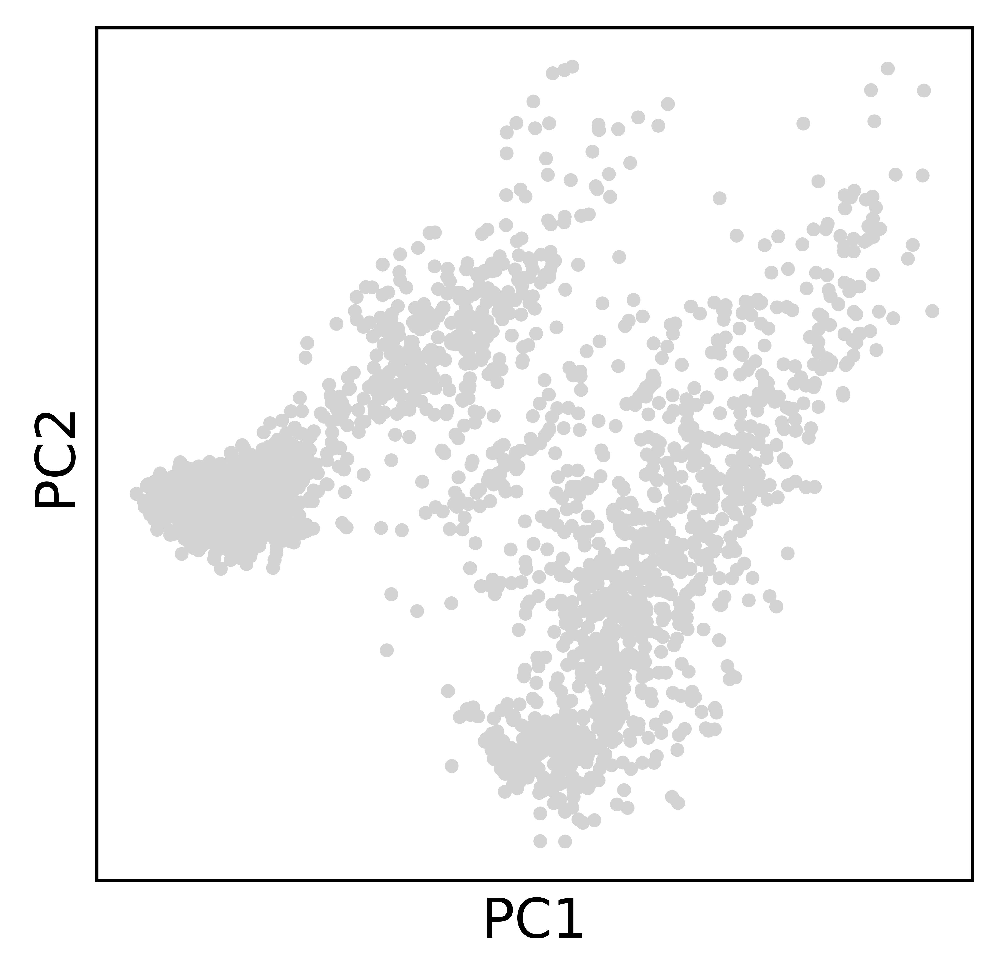

In [16]:
sc.pp.pca(mean_adata)
sc.pl.pca(mean_adata)

Text(0.5, 1.0, '')

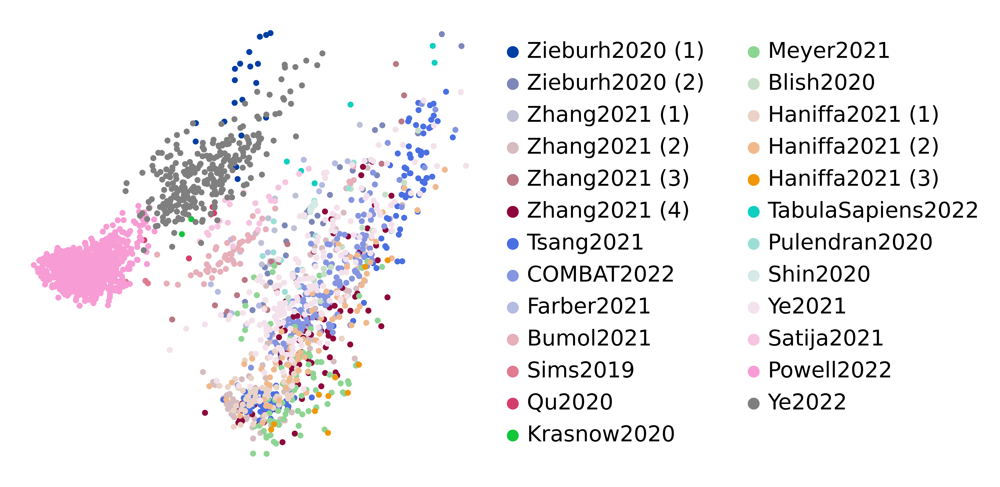

In [21]:
plt.rcParams['figure.dpi'] = 500
fig, ax = plt.subplots(1, 1, figsize=(5, 5))
sc.pl.pca(mean_adata, color='batch_clean', frameon=False, show=False, ax=ax)
ax.set_title('', fontsize=18)
#ax.legend(title='Sex', bbox_to_anchor=(1.05, 1), loc=2, ncol=1, fontsize=12, borderaxespad=0., frameon=False)
#fig.savefig('pbmc/sample_emb_dataset.png', dpi=500, bbox_inches='tight')

Text(0.5, 1.0, '')

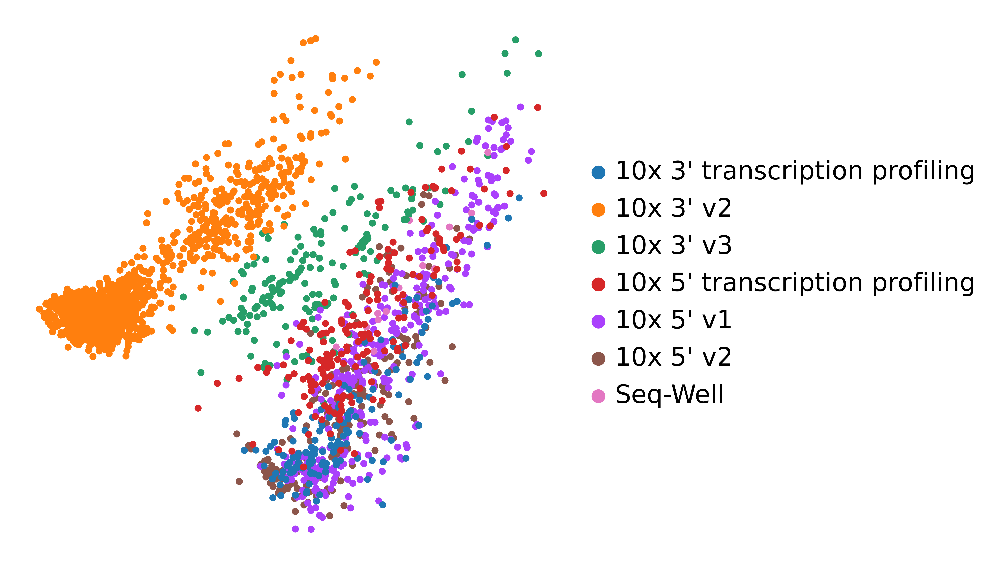

In [22]:
plt.rcParams['figure.dpi'] = 500
fig, ax = plt.subplots(1, 1, figsize=(5, 5))
sc.pl.pca(mean_adata, color='assay', frameon=False, show=False, ax=ax)
ax.set_title('', fontsize=18)
#ax.legend(title='Sex', bbox_to_anchor=(1.05, 1), loc=2, ncol=1, fontsize=12, borderaxespad=0., frameon=False)
#fig.savefig('pbmc/sample_emb_dataset.png', dpi=500, bbox_inches='tight')

Text(0.5, 1.0, '')

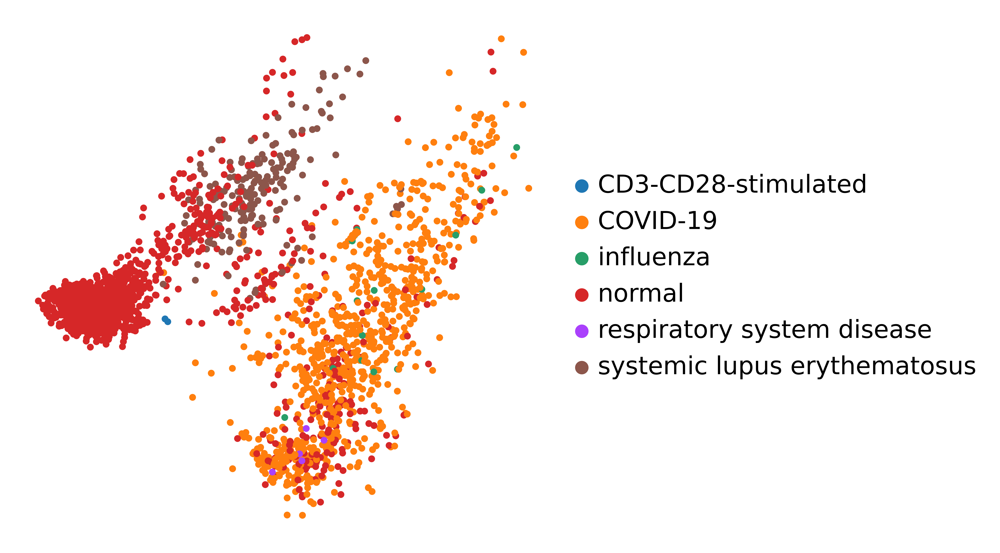

In [23]:
plt.rcParams['figure.dpi'] = 500
fig, ax = plt.subplots(1, 1, figsize=(5, 5))
sc.pl.pca(mean_adata, color='disease', frameon=False, show=False, ax=ax)
ax.set_title('', fontsize=18)
#ax.legend(title='Sex', bbox_to_anchor=(1.05, 1), loc=2, ncol=1, fontsize=12, borderaxespad=0., frameon=False)
#fig.savefig('pbmc/sample_emb_dataset.png', dpi=500, bbox_inches='tight')

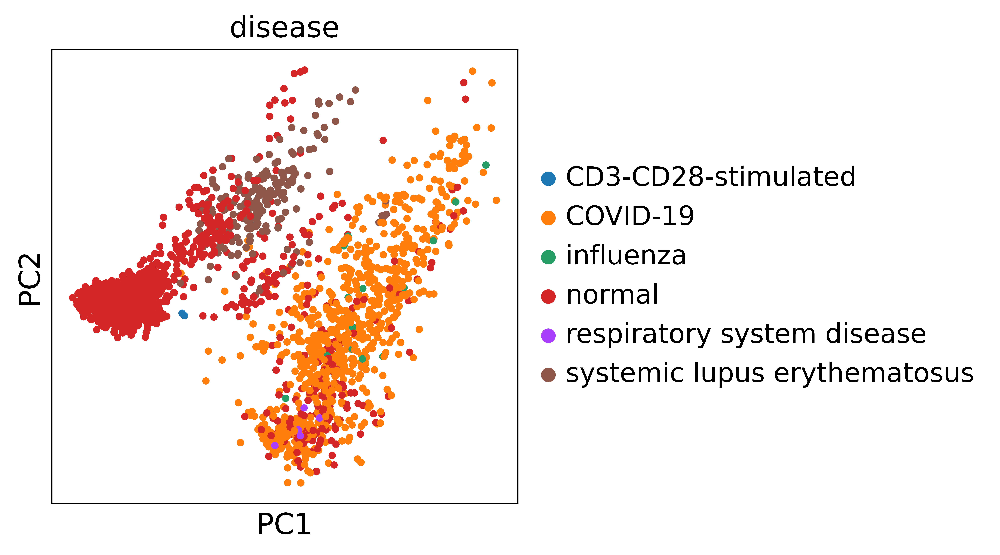

In [17]:
sc.pl.pca(mean_adata, color='disease')

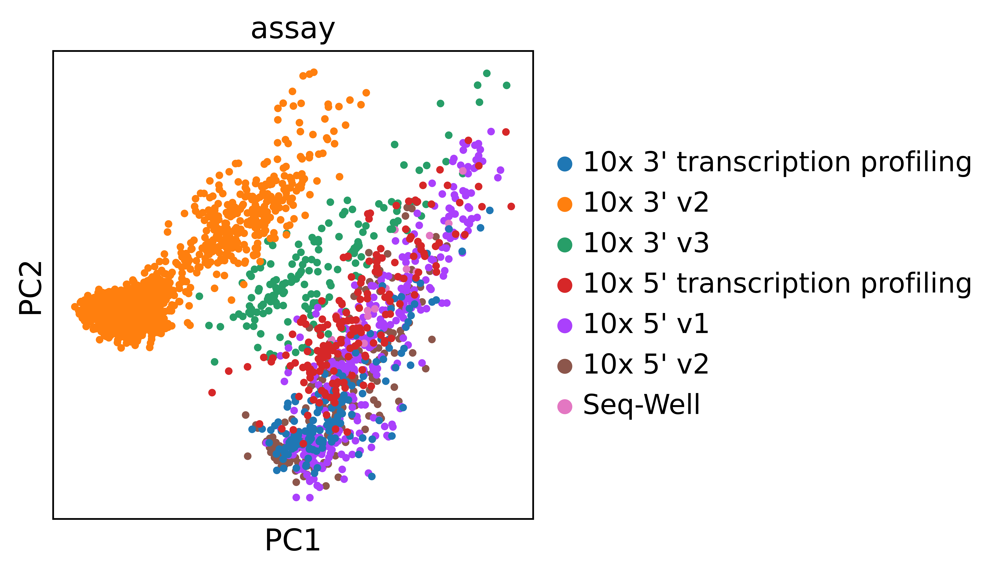

In [18]:
sc.pl.pca(mean_adata, color='assay')

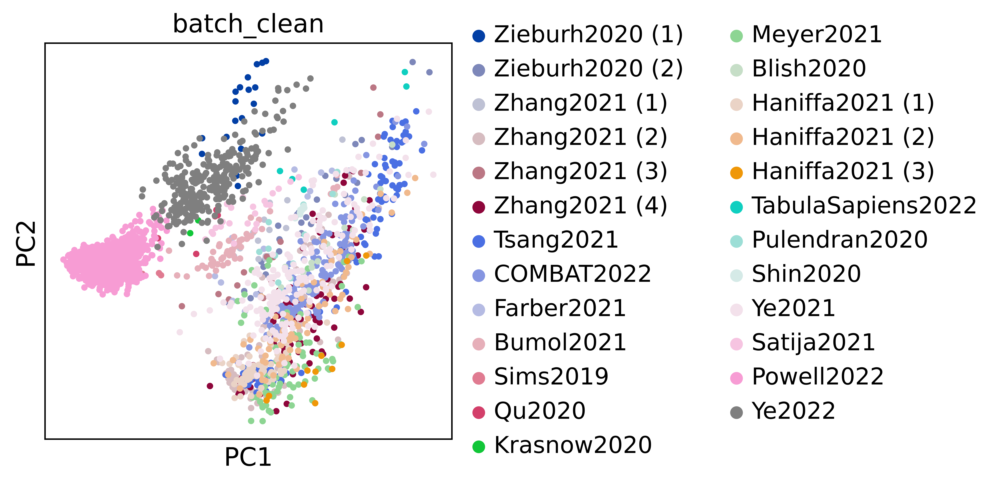

In [19]:
sc.pl.pca(mean_adata, color='batch_clean')

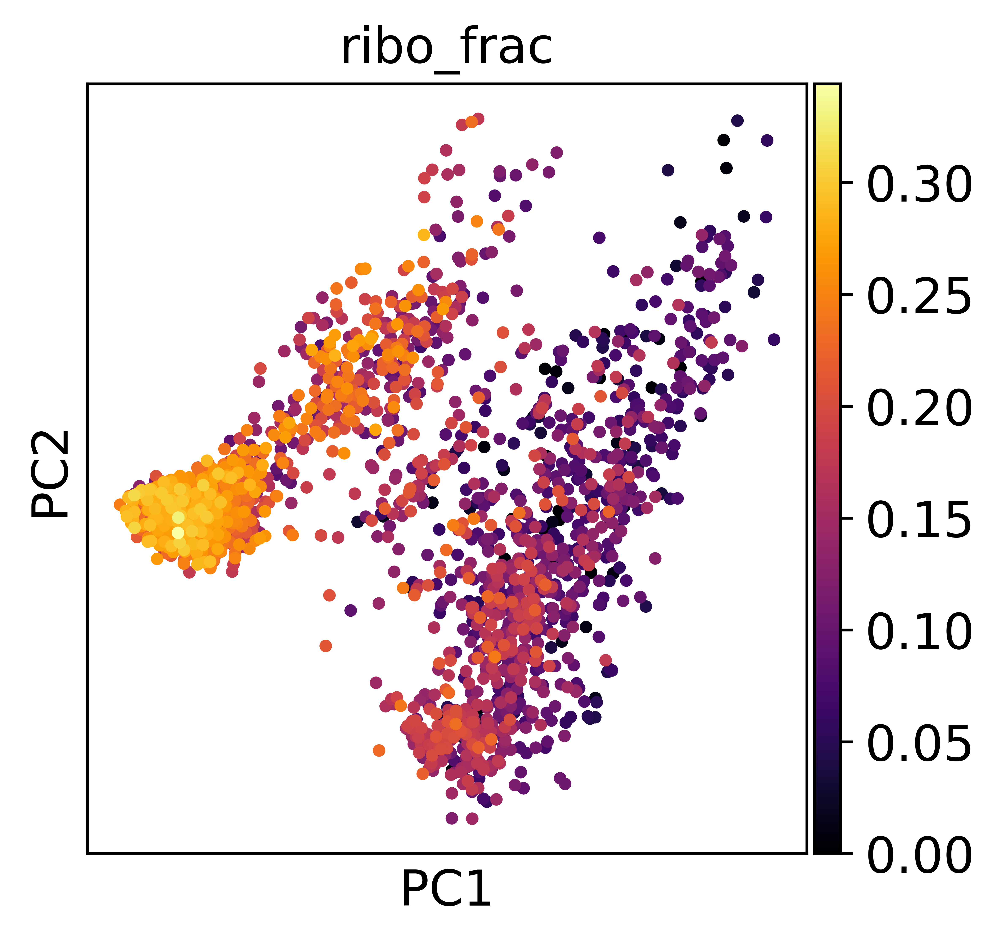

In [29]:
sc.pl.pca(mean_adata, color='ribo_frac', cmap='inferno')

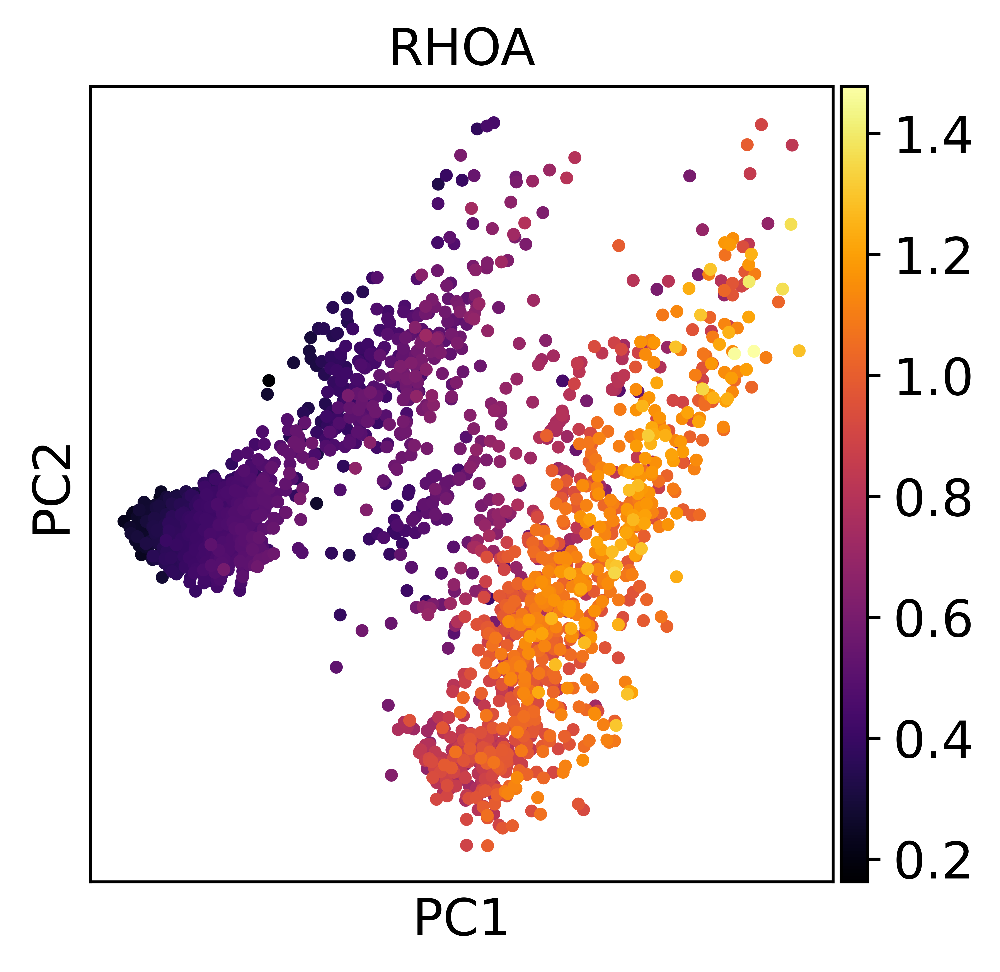

In [33]:
sc.pl.pca(mean_adata, color='RHOA', cmap='inferno')

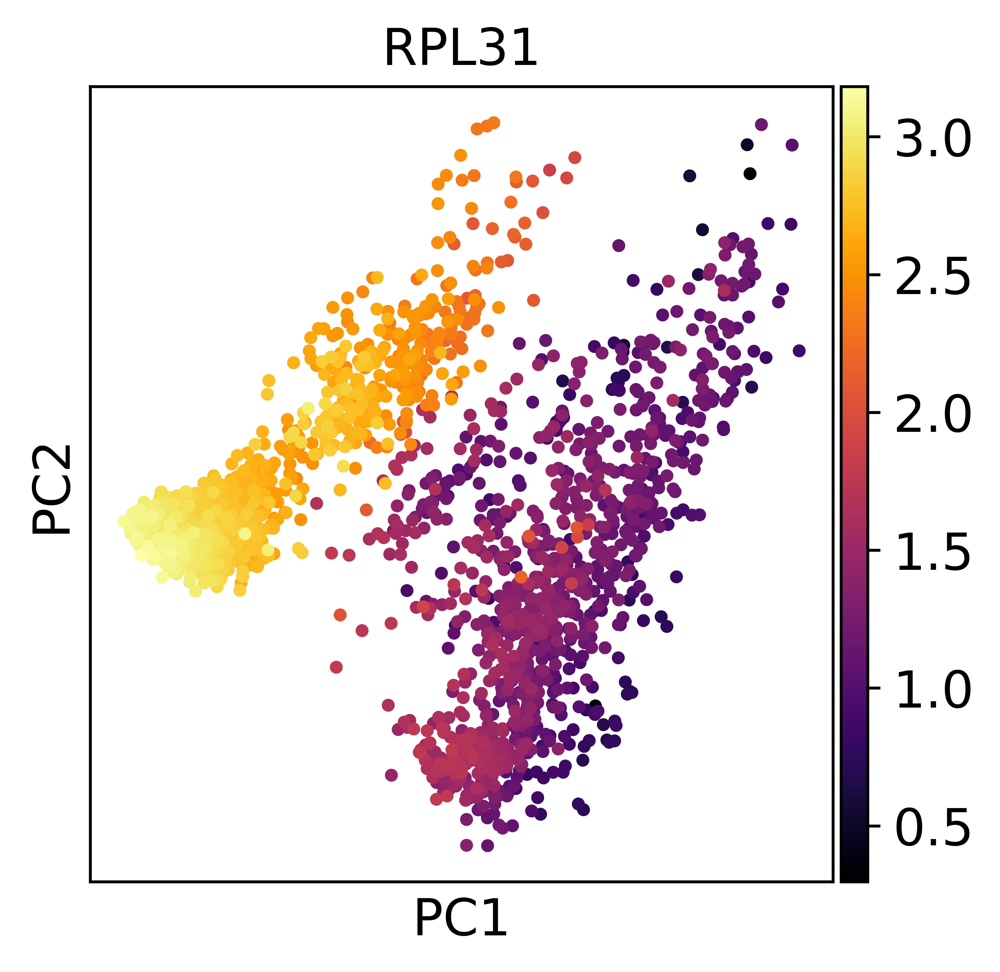

In [32]:
sc.pl.pca(mean_adata, color='RPL31', cmap='inferno')

In [9]:
df = get_mean_gexp(adata_raw, 'sample_ID_lataq')
mean_gexp = pd.concat(df)
adata_emb.obs = pd.concat([adata_emb.obs, mean_gexp], axis=1)

100%|██████████| 2375/2375 [01:58<00:00, 20.12it/s]


In [10]:
from scipy.stats import pearsonr, spearmanr
gene_corr_dict = {}
pval_dict = {}
for i in range(10):
    gene_corr = {}
    pval = {}
    for gene in adata_raw.var_names:
        gene_corr[gene], pval[gene] = pearsonr(adata_emb.obsm['X_pca'][:, i], adata_emb.obs[gene])
    gene_corr_dict[f'PC{i+1}'] = gene_corr
    pval_dict[f'PC{i+1}'] = pval

/home/icb/carlo.dedonno/anaconda3/envs/lataq_cuda/lib/python3.8/site-packages/scipy/stats/stats.py:4023: PearsonRConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(PearsonRConstantInputWarning())


In [11]:
gene_corr = pd.DataFrame(gene_corr_dict)
pval = pd.DataFrame(pval_dict)
gene_corr[pval > 0.01] = 0
gene_corr = gene_corr.dropna()

In [12]:
high_exp_genes = adata_raw.var_names[
    np.where(
        adata_emb.obs[adata_emb.obs.columns[adata_emb.obs.columns.isin(adata_raw.var_names)]].mean() > 0.01
    )[0]
]

In [13]:
gene_corr = gene_corr.loc[high_exp_genes]

In [14]:
gene_corr.sort_values(by='PC1')[:20]

,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,PC9,PC10
external_gene_name,,,,,,,,,,
RPL31,-0.934903,0.079320,0.179649,-0.111445,0.000000,0.000000,-0.089861,0.000000,0.000000,-0.083671
RPS29,-0.911719,0.120762,0.000000,-0.114443,0.167447,0.000000,-0.107209,0.000000,0.112221,-0.155961
RPL38,-0.911104,0.000000,0.000000,0.000000,0.106415,0.000000,-0.081254,-0.069702,0.122938,-0.200068
RPL23A,-0.911051,0.000000,0.059013,-0.084030,0.094153,0.116837,-0.116635,-0.065096,0.000000,0.000000
RPL36A,-0.902655,-0.100011,0.000000,-0.069153,-0.117082,0.098691,0.000000,-0.065292,0.109937,-0.199565
RPS20,-0.895804,0.135379,0.150554,-0.129286,0.195648,0.056113,-0.066601,0.000000,0.000000,-0.085580
RPL35,-0.893783,0.074580,0.000000,-0.111596,-0.097261,0.000000,-0.127147,-0.121961,0.072149,0.000000
RPL37A,-0.889005,0.000000,0.000000,-0.064021,0.206654,0.064401,-0.090683,0.000000,0.106109,-0.196082
RPL7,-0.880356,0.108402,0.197180,-0.192878,0.096228,0.055647,-0.175273,0.000000,-0.072761,-0.081285


In [15]:
gene_corr.sort_values(by='PC2')

,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,PC9,PC10
external_gene_name,,,,,,,,,,
ZGPAT,0.000000,-0.707860,0.089579,0.244337,-0.376126,0.000000,0.286226,-0.084811,0.058283,0.000000
RPL7A,0.000000,-0.692038,0.000000,0.285446,-0.082045,0.168406,0.000000,-0.133572,0.000000,0.107734
SSR2,0.000000,-0.667714,0.254294,0.070179,0.000000,0.000000,0.000000,-0.075003,-0.142567,0.096568
BSCL2,0.000000,-0.658266,0.000000,0.166236,-0.411294,0.000000,0.215358,-0.056052,0.073778,0.000000
AKR1B1,0.183716,-0.654501,0.186829,0.000000,-0.096096,-0.215467,0.133842,-0.096850,-0.134352,0.117760
...,...,...,...,...,...,...,...,...,...,...
TREX1,0.296015,0.552719,0.449163,0.000000,-0.069283,0.086156,0.084811,-0.120178,-0.124382,0.000000
AK6,0.285553,0.555381,0.474829,0.000000,0.000000,0.000000,0.087453,-0.156781,-0.228982,-0.082419
WASH4P,0.213354,0.563305,0.497905,0.180343,0.000000,0.183993,0.000000,-0.165180,-0.183864,-0.127032


In [16]:
gene_corr.sort_values(by='PC3')

,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,PC9,PC10
external_gene_name,,,,,,,,,,
SRGAP2B,0.231564,-0.107103,-0.606843,0.096539,0.191491,0.000000,0.227869,0.000000,0.000000,0.173793
CBWD5,0.271420,-0.076346,-0.565592,-0.083690,-0.073830,0.092612,0.165980,-0.158840,0.072622,0.223952
SRGAP2C,0.000000,-0.212995,-0.560337,-0.080341,0.187906,0.062095,0.132655,0.130783,0.080468,0.000000
DDX52,0.165308,-0.323968,-0.527599,0.000000,0.394638,-0.114224,0.063694,0.222453,0.171388,0.000000
CSNK2A1,0.414047,-0.133086,-0.503517,0.000000,0.382505,-0.133828,0.201718,0.000000,0.072267,0.144300
...,...,...,...,...,...,...,...,...,...,...
SIK1,0.275994,0.450463,0.415954,0.303927,0.000000,0.182448,0.000000,-0.138803,-0.177444,0.000000
UBB,-0.226857,0.067590,0.438546,-0.068339,0.000000,0.000000,-0.063720,0.000000,0.087446,0.132571
TREX1,0.296015,0.552719,0.449163,0.000000,-0.069283,0.086156,0.084811,-0.120178,-0.124382,0.000000


In [17]:
gene_corr.sort_values(by='PC4')

,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,PC9,PC10
external_gene_name,,,,,,,,,,
ATP6V0E1,0.427492,-0.091439,0.000000,-0.553280,-0.078280,-0.229294,0.234969,0.072664,-0.122347,0.062285
RPS27L,0.146669,0.000000,-0.066056,-0.543849,0.082436,-0.270160,0.162761,0.150512,0.067104,-0.066735
FKBP3,0.274273,-0.193968,0.000000,-0.535038,0.105899,-0.247441,0.137807,0.060500,0.000000,0.000000
RBX1,0.334802,0.231740,-0.111675,-0.532419,0.000000,-0.222997,0.170215,0.065873,0.000000,0.066476
CISD1,0.170979,-0.193375,-0.106014,-0.515832,-0.165662,-0.345346,0.253700,0.000000,-0.119245,0.000000
...,...,...,...,...,...,...,...,...,...,...
SLC7A5,0.423483,0.072036,0.105391,0.592787,0.117257,0.077848,0.127284,0.000000,0.000000,0.000000
ZC3H12A,0.401998,0.081251,0.187367,0.597458,0.120294,0.147364,-0.064452,0.000000,0.000000,0.000000
NR4A2,0.203712,0.110031,0.218818,0.633034,0.000000,0.186345,-0.092179,-0.097506,0.000000,0.097579


In [18]:
gene_corr.sort_values(by='PC5')

,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,PC9,PC10
external_gene_name,,,,,,,,,,
PLSCR3,0.307899,-0.475289,-0.159220,0.000000,-0.536848,0.166123,0.150285,-0.163988,0.079121,0.122660
MIF,-0.180778,-0.611540,0.000000,0.197332,-0.530812,0.000000,0.101819,0.000000,0.125980,-0.057741
IFITM1,0.000000,-0.448397,0.074881,0.179947,-0.490003,-0.070146,0.279871,0.179797,0.210826,0.000000
NME2,-0.182493,-0.625352,-0.166854,0.132692,-0.485285,0.208643,0.137965,0.000000,0.097082,0.106604
GABARAP,0.347430,-0.506648,0.000000,0.082467,-0.484412,0.091911,0.139161,0.000000,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...
VEGFB,0.167670,0.000000,-0.256878,0.000000,0.646048,-0.055074,0.000000,0.000000,0.000000,0.000000
MT-CO3,0.060357,0.000000,-0.204581,-0.119259,0.647985,0.407742,-0.221501,-0.112500,-0.146392,-0.070211
CTDNEP1,0.138096,0.000000,-0.291857,0.000000,0.659021,0.000000,0.097097,0.148042,-0.105042,-0.092974


Text(0.5, 1.0, 'Ribosomal fraction')

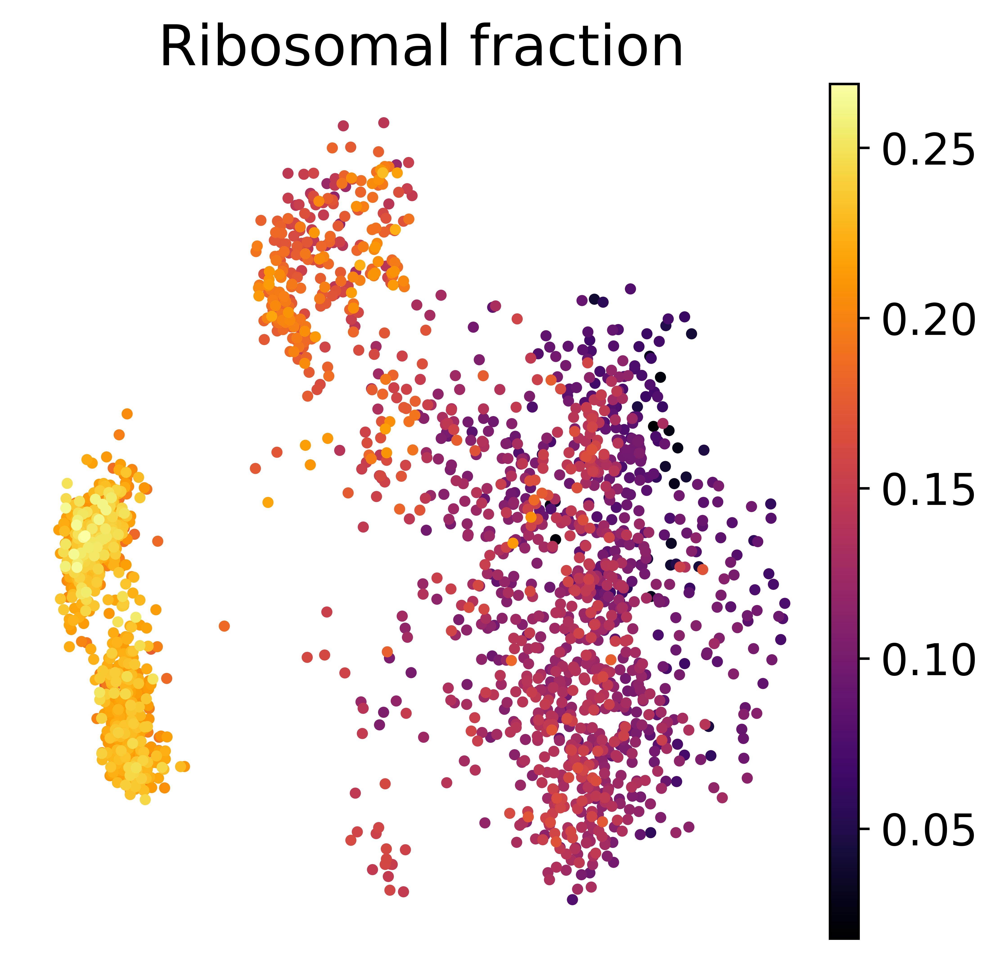

In [22]:
plt.rcParams['figure.dpi'] = 500
fig, ax = plt.subplots(1, 1, figsize=(5, 5))
sc.pl.pca(adata_emb, color='ribo_frac', frameon=False, show=False, ax=ax, cmap='inferno')
ax.set_title('Ribosomal fraction', fontsize=18)
#ax.legend(title='Sex', bbox_to_anchor=(1.05, 1), loc=2, ncol=1, fontsize=12, borderaxespad=0., frameon=False)
#fig.savefig('pbmc/sample_emb_dataset.png', dpi=500, bbox_inches='tight')

Text(0.5, 1.0, 'Mitochondrial fraction')

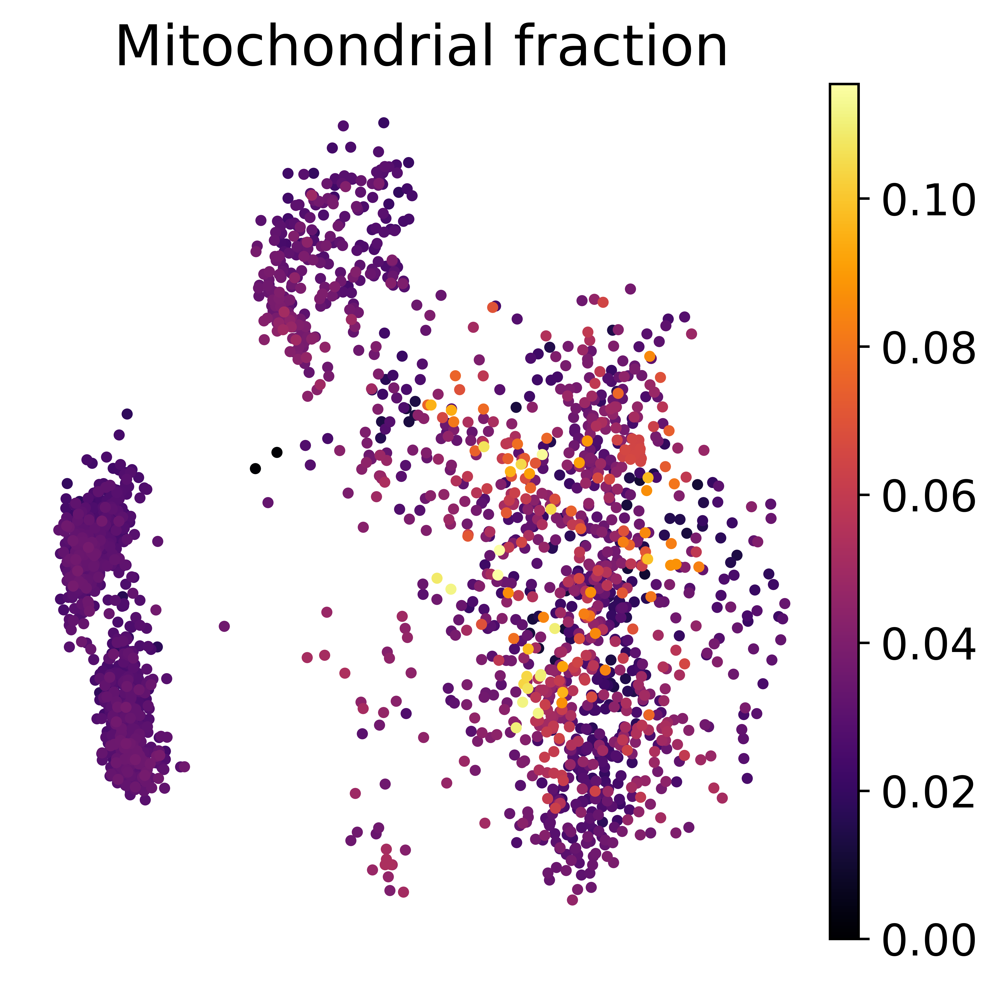

In [37]:
plt.rcParams['figure.dpi'] = 500
fig, ax = plt.subplots(1, 1, figsize=(5, 5))
sc.pl.pca(adata_emb, color='mt_frac', frameon=False, show=False, ax=ax, cmap='inferno')
ax.set_title('Mitochondrial fraction', fontsize=18)
#ax.legend(title='Sex', bbox_to_anchor=(1.05, 1), loc=2, ncol=1, fontsize=12, borderaxespad=0., frameon=False)
#fig.savefig('pbmc/sample_emb_dataset.png', dpi=500, bbox_inches='tight')

In [24]:
adata = sc.read('../data/soroor_rerun/czi_8M_pbmc_cell_embedding_fulldataset.h5ad')
adata = adata[~adata.obs_names.duplicated()]

/home/icb/carlo.dedonno/anaconda3/envs/lataq_cuda/lib/python3.8/site-packages/anndata/_core/anndata.py:1828: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


In [25]:
common_obs = adata_raw.obs_names[adata_raw.obs_names.isin(adata.obs_names)]

In [26]:
adata_sub = adata_raw[common_obs]
adata = adata[common_obs]
adata_sub.obsm['X_umap'] = adata.obsm['X_umap']

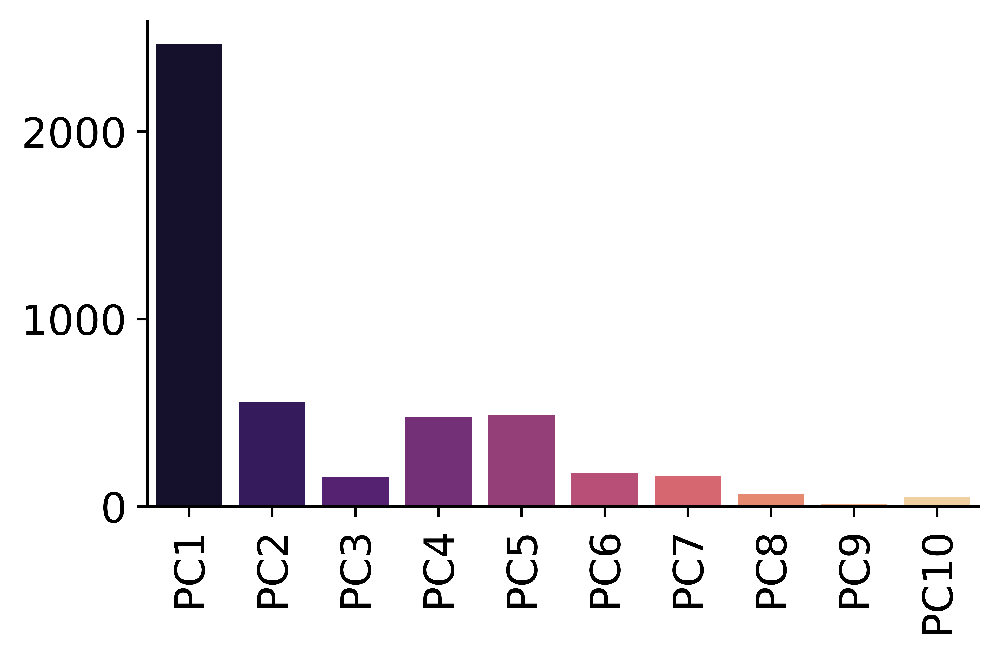

In [30]:
fig, ax = plt.subplots(1, 1, figsize=(5, 3))
sns.barplot(x = gene_corr.columns, y=(gene_corr.abs()>0.3).sum().values, palette='magma')
l = ax.get_xticklabels()
sns.despine()
ax.grid(False)
ax.set_xticklabels(l, rotation=90)
fig.savefig('pbmc/pc_sign.png', dpi=500, bbox_inches='tight')

Text(0.5, 0.98, 'RPL31 ($r_{PC1}$=-0.93)')

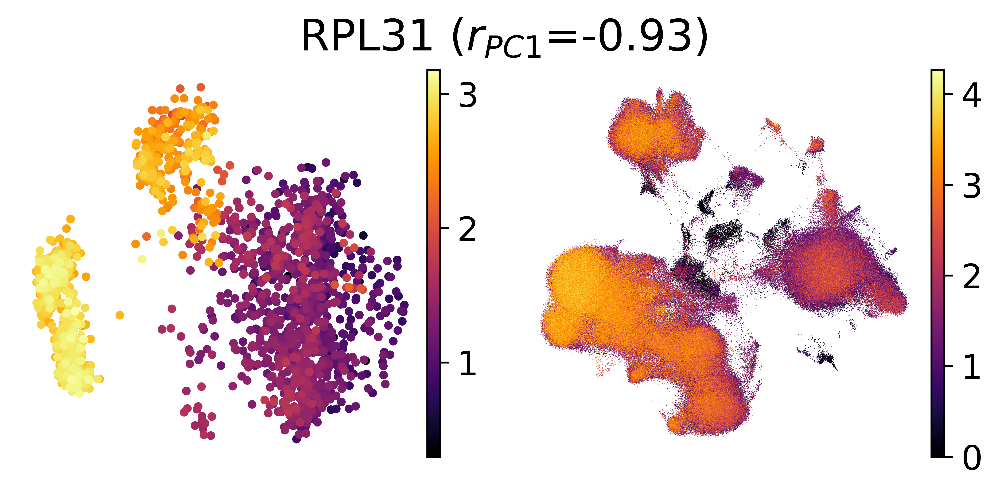

In [29]:
plt.rcParams['figure.dpi'] = 500
fig, ax = plt.subplots(1, 2, figsize=(6, 3))
gene = "RPL31"
sc.pl.pca(adata_emb, color=gene, color_map='inferno', frameon=False, show=False, ax=ax[0])
ax[0].set_title('')
sc.pl.umap(adata_sub, color=gene, s=0.2, cmap='inferno', frameon=False, show=False, ax=ax[1])
ax[1].set_title('')
fig.tight_layout(rect=[0, 0.03, 1, 0.95])
fig.suptitle(f'{gene} ($r_{{PC1}}$={gene_corr.loc[gene].PC1:.2f})', fontsize=18)
#ax.legend(title='RPL31', bbox_to_anchor=(1.05, 1), loc=2, ncol=2, fontsize=12, borderaxespad=0., frameon=False)
#fig.savefig(f'pbmc/{gene}.png', dpi=500, bbox_inches='tight')

Text(0.5, 0.98, 'RHOA ($r_{PC1}$=0.85)')

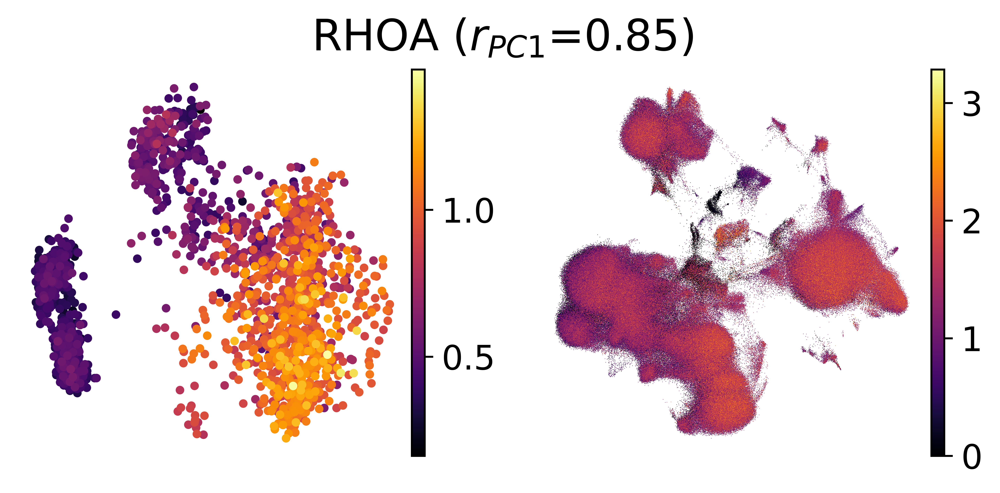

In [30]:
plt.rcParams['figure.dpi'] = 500
fig, ax = plt.subplots(1, 2, figsize=(6, 3))
gene = "RHOA"
sc.pl.pca(adata_emb, color=gene, color_map='inferno', frameon=False, show=False, ax=ax[0])
ax[0].set_title('')
sc.pl.umap(adata_sub, color=gene, s=0.2, cmap='inferno', frameon=False, show=False, ax=ax[1])
ax[1].set_title('')
fig.tight_layout(rect=[0, 0.03, 1, 0.95])
fig.suptitle(f'{gene} ($r_{{PC1}}$={gene_corr.loc[gene].PC1:.2f})', fontsize=18)
#ax.legend(title='RPL31', bbox_to_anchor=(1.05, 1), loc=2, ncol=2, fontsize=12, borderaxespad=0., frameon=False)
#fig.savefig(f'pbmc/{gene}.png', dpi=500, bbox_inches='tight')

Text(0.5, 0.98, 'SSR2 ($r_{PC2}$=-0.67)')

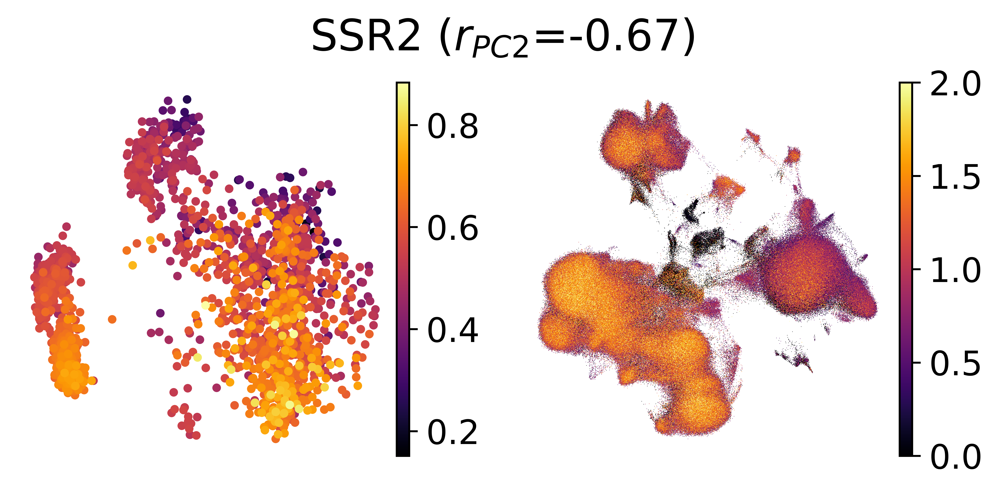

In [34]:
plt.rcParams['figure.dpi'] = 500
fig, ax = plt.subplots(1, 2, figsize=(6, 3))
gene = "SSR2"
sc.pl.pca(adata_emb, color=gene, color_map='inferno', frameon=False, show=False, ax=ax[0], components='1, 2')
ax[0].set_title('')
sc.pl.umap(adata_sub, color=gene, s=0.2, cmap='inferno', frameon=False, show=False, ax=ax[1], vmax=2)
ax[1].set_title('')
fig.tight_layout(rect=[0, 0.03, 1, 0.95])
fig.suptitle(f'{gene} ($r_{{PC2}}$={gene_corr.loc[gene].PC2:.2f})', fontsize=18)
#ax.legend(title='RPL31', bbox_to_anchor=(1.05, 1), loc=2, ncol=2, fontsize=12, borderaxespad=0., frameon=False)
#fig.savefig(f'pbmc/{gene}.png', dpi=500, bbox_inches='tight')

Text(0.5, 0.98, 'TSPYL2 ($r_{PC4}$=0.64)')

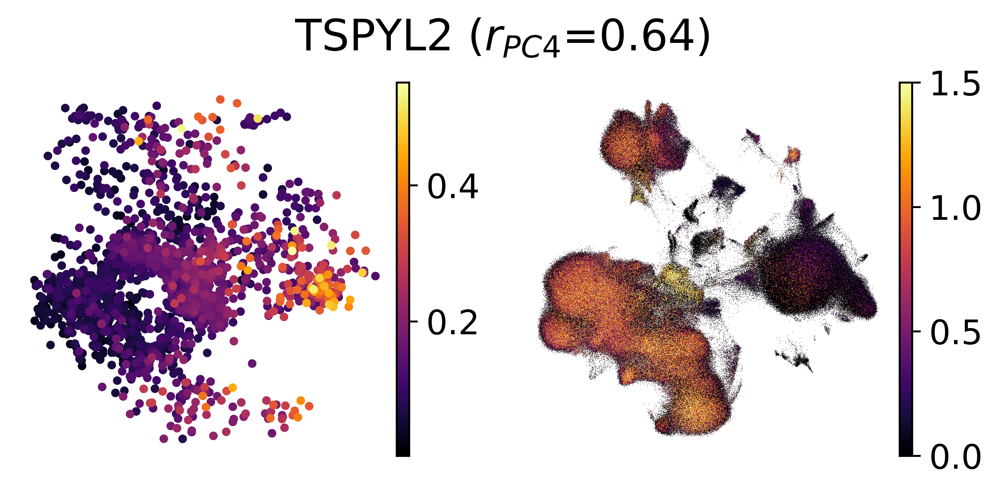

In [35]:
plt.rcParams['figure.dpi'] = 500
fig, ax = plt.subplots(1, 2, figsize=(6, 3))
gene = "TSPYL2"
sc.pl.pca(adata_emb, color=gene, color_map='inferno', frameon=False, show=False, ax=ax[0], components='4, 5')
ax[0].set_title('')
sc.pl.umap(adata_sub, color=gene, s=0.2, cmap='inferno', frameon=False, show=False, ax=ax[1], vmax=1.5)
ax[1].set_title('')
fig.tight_layout(rect=[0, 0.03, 1, 0.95])
fig.suptitle(f'{gene} ($r_{{PC4}}$={gene_corr.loc[gene].PC4:.2f})', fontsize=18)
#ax.legend(title='RPL31', bbox_to_anchor=(1.05, 1), loc=2, ncol=2, fontsize=12, borderaxespad=0., frameon=False)
#fig.savefig(f'pbmc/{gene}.png', dpi=500, bbox_inches='tight')

In [46]:
gene_corr[gene_corr['PC1'].abs()>0.3]['PC1'].sort_values().to_csv('pc1.csv')
gene_corr[gene_corr['PC2'].abs()>0.3]['PC2'].sort_values().to_csv('pc2.csv')
gene_corr[gene_corr['PC5'].abs()>0.3]['PC5'].sort_values().to_csv('pc5.csv')

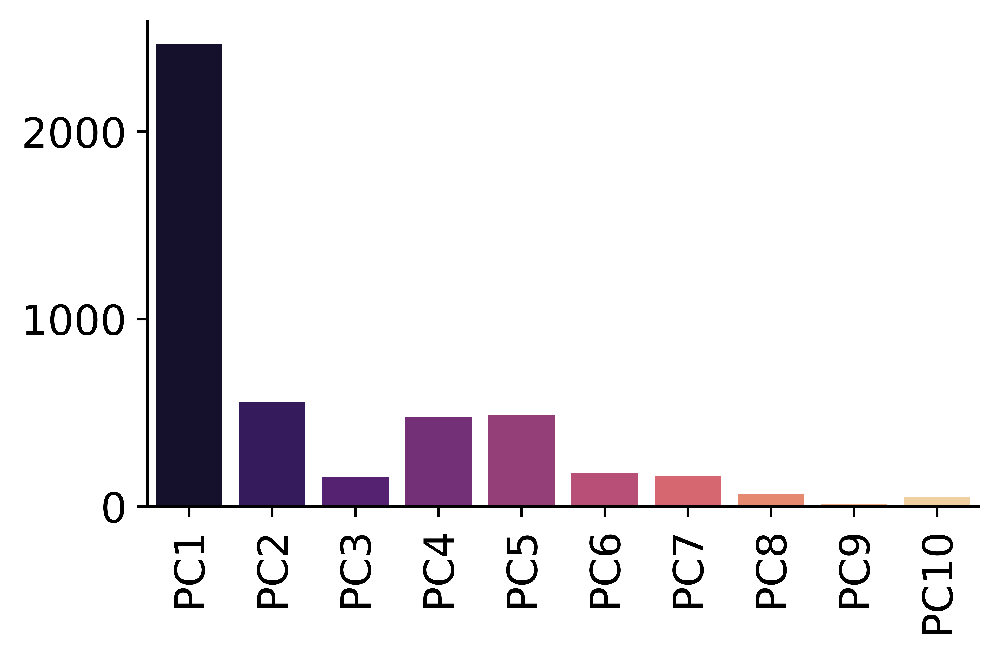

In [45]:
fig, ax = plt.subplots(1, 1, figsize=(5, 3))
sns.barplot(x = gene_corr.columns, y=(gene_corr.abs()>0.3).sum().values, palette='magma')
l = ax.get_xticklabels()
sns.despine()
ax.grid(False)
ax.set_xticklabels(l, rotation=90)
fig.savefig('pbmc/pc_sign.png', dpi=500, bbox_inches='tight')

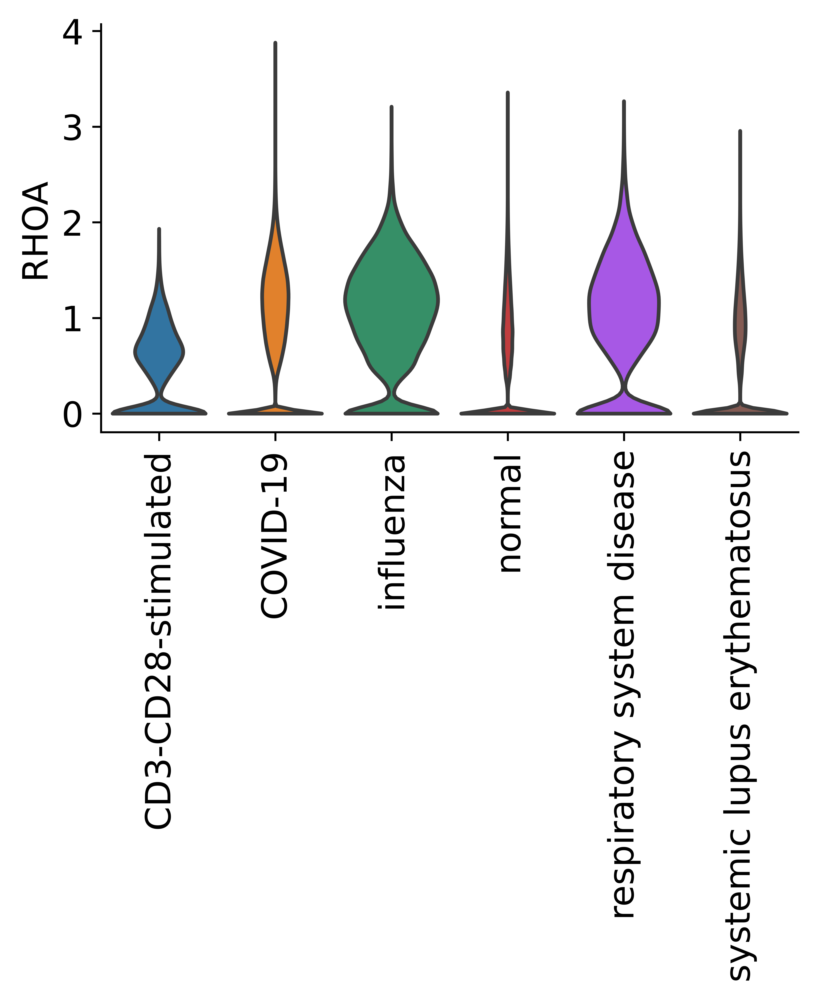

In [37]:
fig, ax = plt.subplots(1, 1, figsize=(5, 3))
sc.pl.violin(adata_raw, keys='RHOA', groupby='disease', rotation=90, stripplot=False, show=False, ax=ax)
ax.grid(False)
sns.despine()

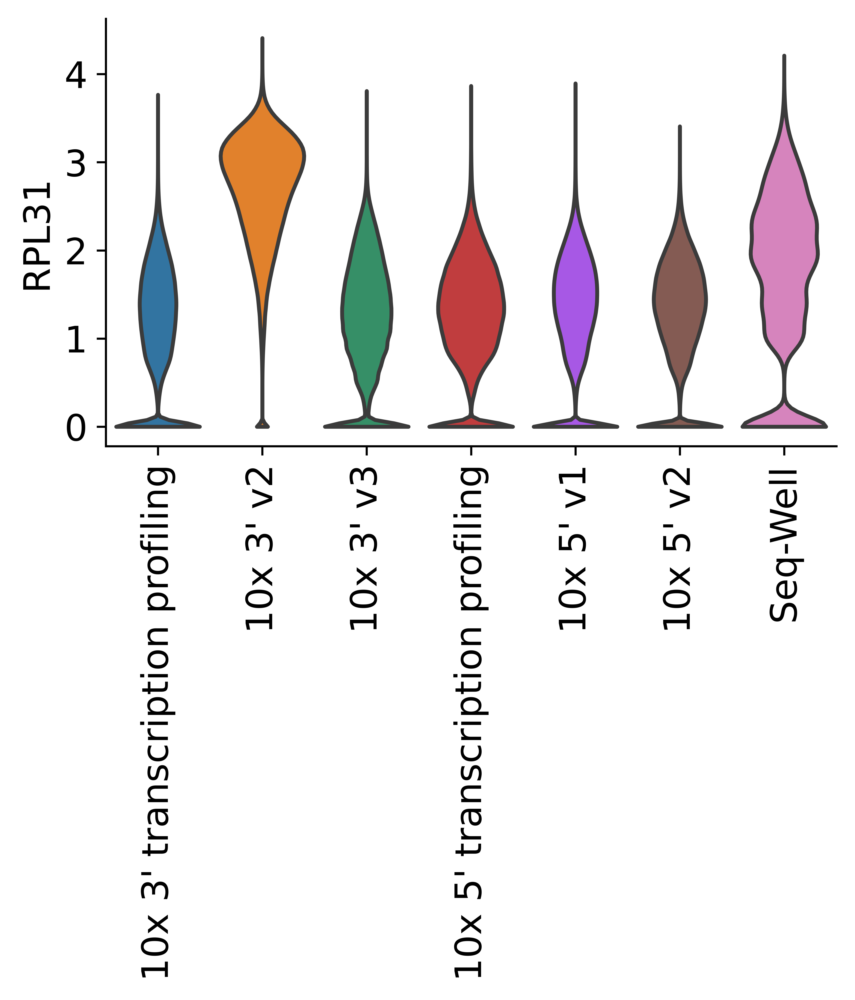

In [47]:
fig, ax = plt.subplots(1, 1, figsize=(5, 3))
sc.pl.violin(adata_raw, keys='RPL31', groupby='assay', rotation=90, stripplot=False, show=False, ax=ax)
ax.grid(False)
sns.despine()

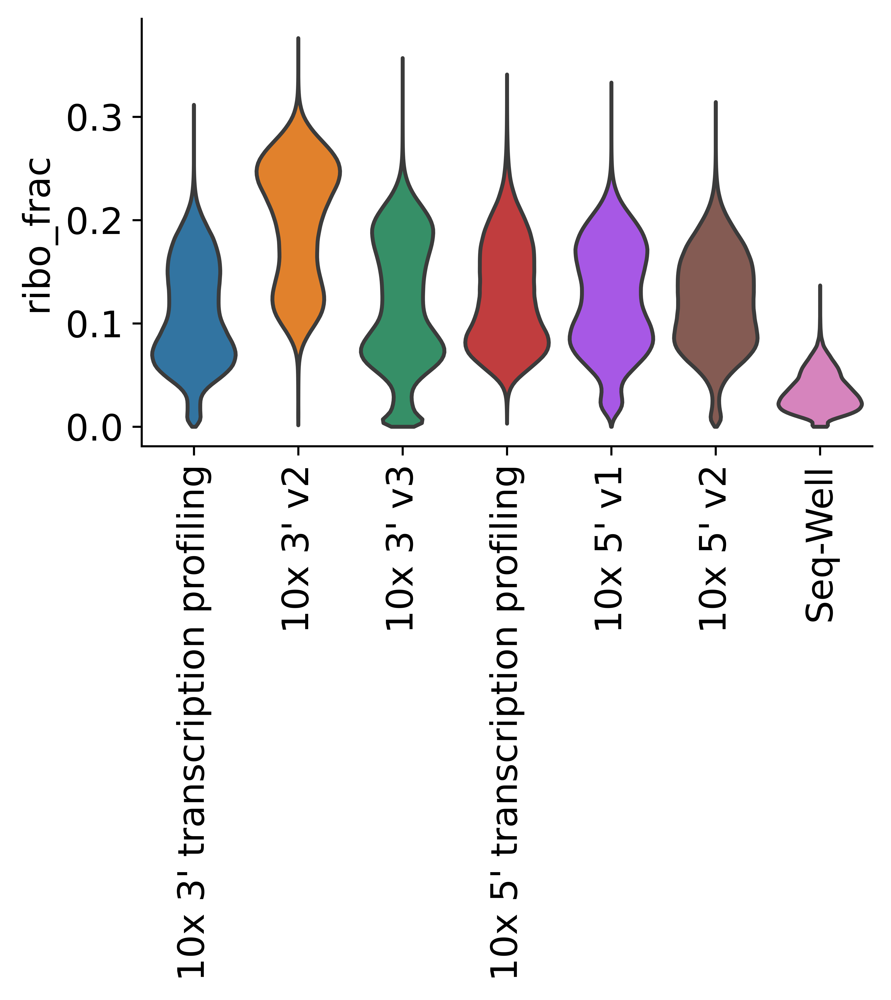

In [36]:
fig, ax = plt.subplots(1, 1, figsize=(5, 3))
sc.pl.violin(adata_raw, keys='ribo_frac', groupby='assay', rotation=90, stripplot=False, show=False, ax=ax)
ax.grid(False)
sns.despine()